In [1]:
#Import libraries
import pandas as pd
import socket
import requests
import math
import matplotlib.pyplot as plt
import numpy as np

In [2]:
full_data = pd.read_csv('SFlow Data -Sem 1 2020.csv', header=None)
#Display full data
full_data.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,FLOW,203.30.38.251,129,193,00135f21bc80,0031466b23cf,0x0800,11.0,919,155.69.160.77,74.125.130.141,6,0x60,59,57577.0,443,0x10,74,52,2048
1,FLOW,203.30.38.251,129,193,00135f21bc80,0031466b23cf,0x0800,11.0,919,155.69.160.78,74.125.203.128,6,0x00,59,34809.0,443,0x10,1442,1420,2048
2,FLOW,203.30.38.251,131,193,001cb0c88e40,0031466b23cf,0x0800,43.0,919,192.122.131.134,74.125.10.12,6,0x00,57,50549.0,443,0x10,102,80,2048
3,FLOW,203.30.38.251,135,129,002688cd5fc7,00135f21bc80,0x0800,919.0,11,54.169.229.179,155.69.191.254,17,0x00,57,16285.0,39641,0x10,580,562,2048
4,FLOW,203.30.38.251,193,130,0031466b23cf,00239cd087c1,0x0800,919.0,919,209.85.229.247,137.132.228.34,17,0x00,63,443.0,32817,0x00,1396,1378,2048


In [3]:
#Functions

#Count Occurence of all the items in a column into a dictionary
def countOccurrence(data_list): 
    dct = {} 
    for i in data_list: 
        if not dct.get(i): 
            dct[i] = 0
        dct[i] += 1
    return dct 

#Get top 5 occurence from a list
def getTop5(dct,mode):
    i = 0 #intialize count variable 
    for w in sorted(dct, key=dct.get, reverse=True):
        if (i<5):
            print(w,": ",dct[w])
            #If mode is org
            if (mode=="org"):
                findorg(w)
            elif (mode=="port"):
                findportname(w)
            i+=1

#Get ip
def findorg(ip):
    try:
        r = requests.get("http://free.ipwhois.io/json/"+ip)
        r = r.json()
        print(r['org'])
    except:
        print("Error")

#Get port
def findportname(port):
    try:
        serviceName = socket.getservbyport(port, "tcp")
        print(serviceName)
    except:
        try:
            serviceName = socket.getservbyport(port, "udp")
            print(serviceName)
        except:
            if (port>1023 and port<49152):
                print("Registered Port")
            elif (port>49151):
                print("Private Port")
            else:
                print("Error")

#Get Sum
def getSum(lst):
    print("Total Traffic: ",lst.sum(),"MB")

#Get Proportion of TCP and UDP Packets
def getProportion(occurence):
    print("Occurence of TCP: ",occurence[6])
    print("Occurence of UDP: ",occurence[17])
    #Print Ratio of TCP:UDP
    ratio_tcp = math.floor(occurence[6]/(occurence[6]+occurence[17])*10000)/100
    ratio_UDP = math.floor(occurence[17]/(occurence[6]+occurence[17])*10000)/100
    print()
    print("Ratio Proportion of TCP:UDP")
    print(ratio_tcp,"% :",ratio_UDP,"%")

In [4]:
#Get Talker List
talker_list = countOccurrence(full_data[9])
#Print top 5
print("Top 5 Talkers: ")
getTop5(talker_list,"org")


Top 5 Talkers: 
103.26.47.233 :  9646
Multimedia Development Corporation
13.107.4.50 :  4950
Microsoft Corporation
155.69.160.78 :  4563
Nanyang Technological University
130.14.250.7 :  3914
National Library of Medicine
173.194.22.215 :  2896
Google LLC


In [5]:
#Get Listener List
listeners_list = countOccurrence(full_data[10])
#Print top 5
print("Top 5 Listeners: ")
getTop5(listeners_list,"org")


Top 5 Listeners: 
103.22.221.73 :  9646
National Infomation Society Agency
137.132.228.33 :  7835
National University of Singapore
137.132.228.29 :  5964
National University of Singapore
137.132.228.42 :  4987
National University of Singapore
103.37.198.100 :  3915
A*STAR


In [6]:
#Get Application List
app_list = countOccurrence(full_data[15])
#Print top 5
print("Top 5 Applications: ")
getTop5(app_list,"port")


Top 5 Applications: 
443 :  42975
https
80 :  11960
http
56800 :  3918
Private Port
15000 :  2697
Registered Port
44678 :  1158
Registered Port


In [7]:
#Total Traffic from column 17
getSum(full_data[17])

Total Traffic:  4141352578 MB


In [8]:
#Get occurence of TCP and UDP Packets
proportion_list = countOccurrence(full_data[11])
#Print Proportion
getProportion(proportion_list)

Occurence of TCP:  155799
Occurence of UDP:  45377

Ratio Proportion of TCP:UDP
77.44 % : 22.55 %


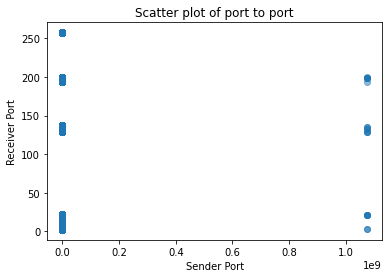

In [9]:
#Additional Analysis Input to Output Ports
#Set variables
x = full_data[3]
y = full_data[2]

# Plot IP to port
plt.scatter(x, y, alpha=0.5)
plt.title('Scatter plot of port to port')
plt.xlabel('Sender Port')
plt.ylabel('Receiver Port')
plt.show()
